# Image Embeddings For Recommendations

Guide taken from https://www.tensorflow.org/tutorials/images/transfer_learning_with_hub

And here https://github.com/lmoroney/dlaicourse/blob/master/Course%202%20-%20Part%206%20-%20Lesson%203%20-%20Notebook.ipynb

And here https://www.analyticsvidhya.com/blog/2020/08/top-4-pre-trained-models-for-image-classification-with-python-code/

And here https://github.com/jaredwinick/img2vec-keras/blob/master/img2vec_keras/img_to_vec.py

In [5]:
from pathlib import Path

In [6]:
IMAGE_DIR = '/Users/grantbeasley/Downloads/images/'
images = Path(IMAGE_DIR)

Quick test of for loop vs list comprehension - no real difference in speed!

In [4]:
%%timeit

all_files = []
for folder in images.iterdir():
    if not folder.name == '.DS_Store':
        for image in folder.iterdir():
            if image.suffix == '.jpg':
                all_files.append(image)

1 loop, best of 3: 254 ms per loop


In [7]:
%%timeit
all_files = [image for folder in images.iterdir() if not folder.name == '.DS_Store' for image in folder.iterdir() if image.suffix == '.jpg']

1 loop, best of 3: 247 ms per loop


In [7]:
all_files = [image for folder in images.iterdir() if not folder.name == '.DS_Store' for image in folder.iterdir() if image.suffix == '.jpg']

In [ ]:
!python load_embddings.py

## Post processing - ensure each image has zero embedding

In [10]:
uri = "bolt://localhost:7687"
driver = GraphDatabase.driver(uri, auth=("neo4j", "password"))

In [25]:
zero_vec = np.zeros(2048).tolist()

In [26]:
with driver.session(database='products') as session:
    results = list(
        session.run(
            """MATCH (p:Product) WHERE p.embedding IS NULL 
               SET p.embedding = $zero_vec RETURN id(p)""", 
            zero_vec=zero_vec
        )
    )

In [8]:
import matplotlib.pyplot as plt
import numpy as np

### Random sample of Products - lets look at most similar items

In [11]:
# Load 20 random products from the database
with driver.session(database = 'products') as session:
    result = session.run(
        """MATCH (p:Product) RETURN p.code as prod_code ORDER BY rand() LIMIT 20"""
    )
    

    prod_sample = [record["prod_code"] for record in result]
    

### Create some helper functions to plot images and recommendations

In [16]:
def plot_item(code, image_files):
    # Lets assume there's only one file for each prod_code
    file = [file for file in image_files if code in file.name]
    if len(file) == 0:
        print(f'No image for {code}')
    else:
        img = image.imread(file[0])
        plt.imshow(img)
    
def return_similar_items(code, driver):
    
    with driver.session(database='products') as session:
        results = session.run(
            """MATCH (p:Product {code: $prod_code})-[s:SIMILAR]->(p2:Product) 
            RETURN p2.code as sim_item, s.score as sim_score ORDER BY sim_score DESC""",
            prod_code = code
        )
        
        sim_items = [(record["sim_item"], record["sim_score"]) for record in results]
    
    return sim_items

def plot_similar_items(code, sim_items, image_files):
    plot_item(code, image_files)
    
    fig, axes = plt.subplots(figsize=(20,12), nrows=2, ncols=5)
    
    for i,ax in zip(sim_items, axes.flatten()):
        file = [file for file in image_files if i[0] in file.name]
        if len(file) == 0:
            continue
        else:
            img = image.imread(file[0])
            ax.imshow(img)
            ax.set_title(i[1])

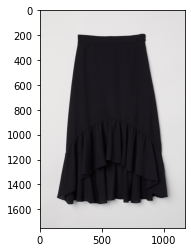

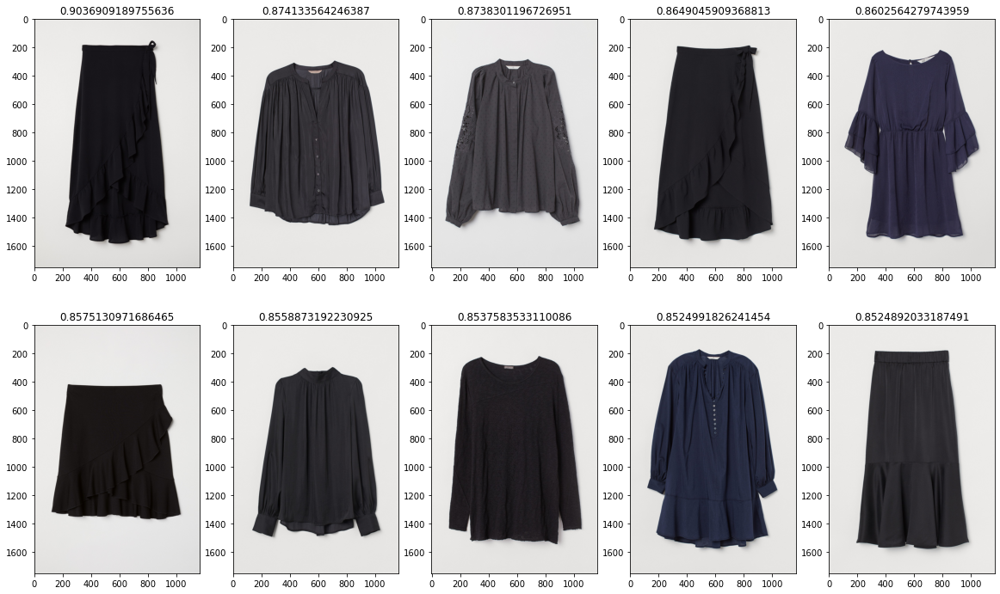

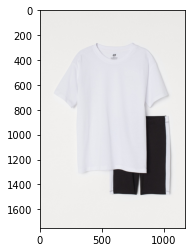

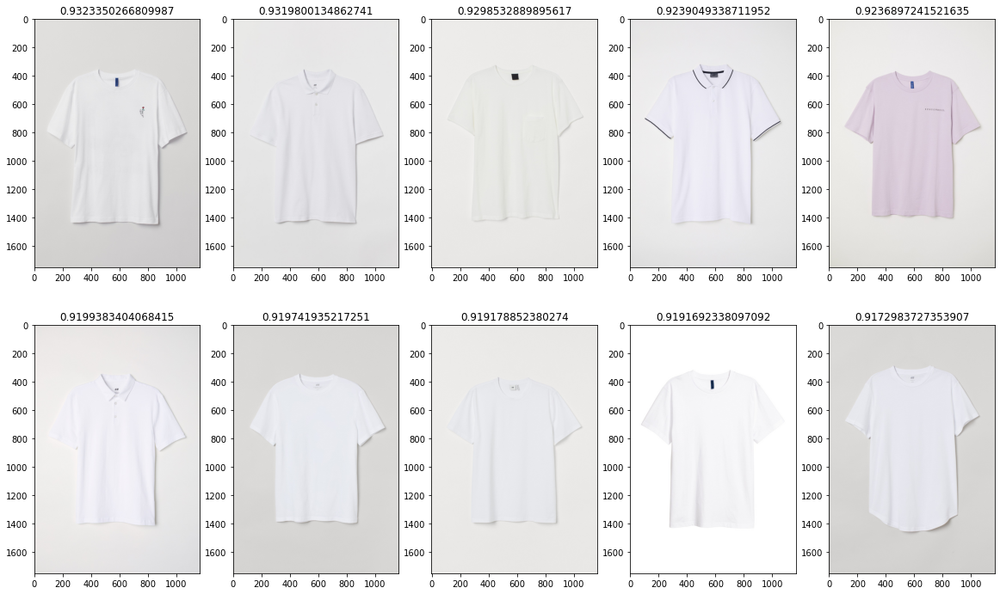

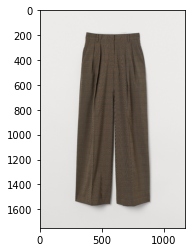

...

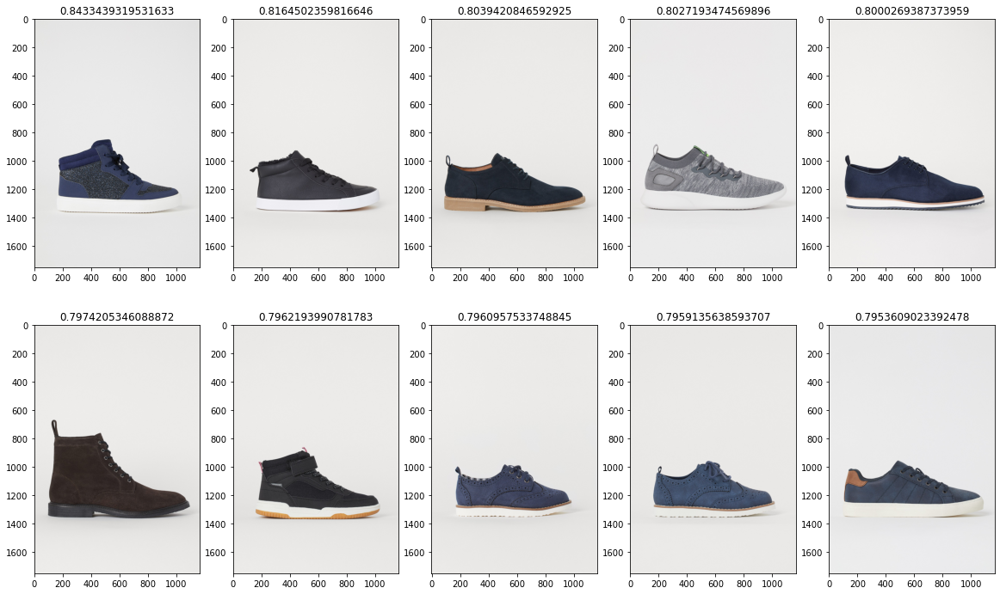

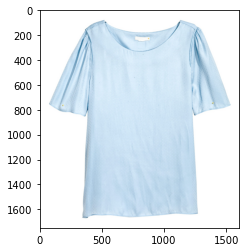

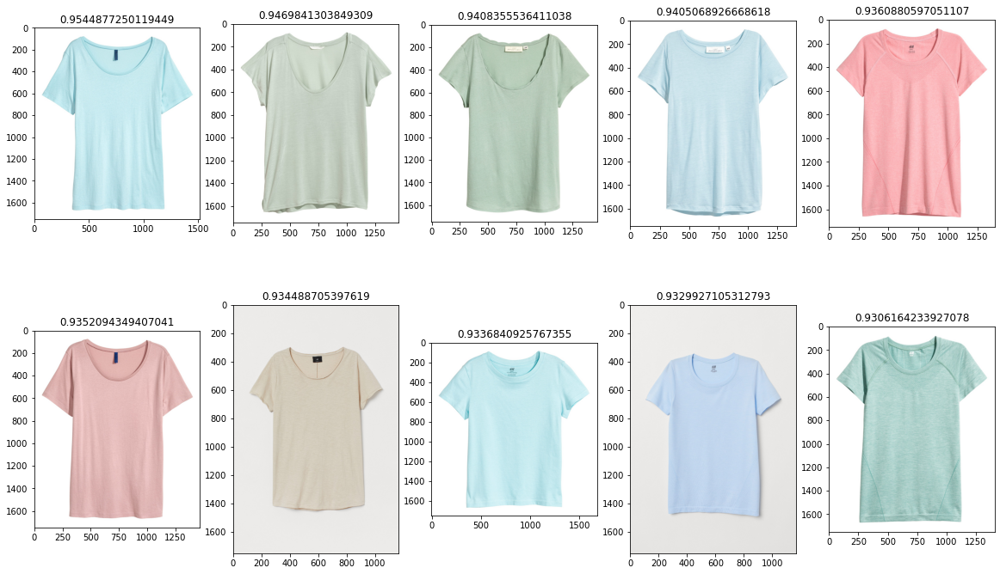

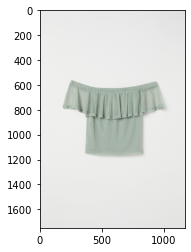

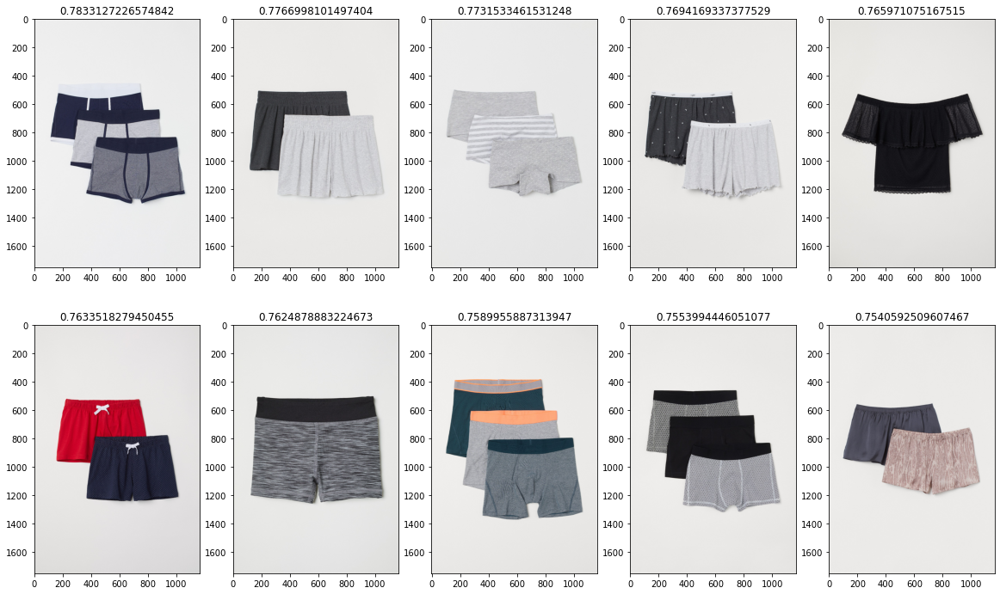

In [23]:
for prod in prod_sample:
    sim_items = return_similar_items(prod, driver)
    plot_similar_items(prod, sim_items, all_files)
    plt.pause(2)

### Using Fabric
We can modify the query above to load product metadata using Neo4j fabric

In [ ]:
def return_similar_items_fabric(code, driver):
    
    with driver.session(database='fabric') as session:
        results = session.run(
            """CALL {
                    USE fabric.products
                    MATCH (p:Product {code: $prod_code})-[s:SIMILAR]->(p2:Product)
                    RETURN p2.code as prod_code, s.score as sim_score
                    }
                CALL{
                    USE fabric.neo4j
                    WITH prod_code
                    MATCH (d:Department)<-[:FROM_DEPARTMENT]-(p:Product {code:prod_code})-[:SUBSET_OF]->(type:ProductType)
                    RETURN type.name as prod_type, d.name as department_name
                    }

            RETURN prod_code, sim_score, prod_type, department_name""",
            prod_code = code
        )
        
        sim_items = [(record["prod_code"], record["sim_score"], record["prod_type"], record["department_name"]) for record in results]
    
    return sim_items

def plot_similar_items_fabric(code, sim_items, image_files):
    plot_item(code, image_files)
    
    fig, axes = plt.subplots(figsize=(20,12), nrows=2, ncols=5)
    
    for i,ax in zip(sim_items, axes.flatten()):
        file = [file for file in image_files if i[0] in file.name]
        if len(file) == 0:
            continue
        else:
            img = image.imread(file[0])
            ax.imshow(img)
            ax.set_title(f'{i[1]:.2f} - {i[2]}\n{i[3]}')

In [40]:
# Load 20 random products from the database. 
with driver.session(database = 'products') as session:
    result = session.run(
        """MATCH (p:Product) RETURN p.code as prod_code ORDER BY rand() LIMIT 20"""
    )
    

    prod_sample = [record["prod_code"] for record in result]

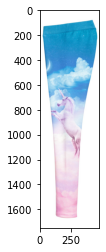

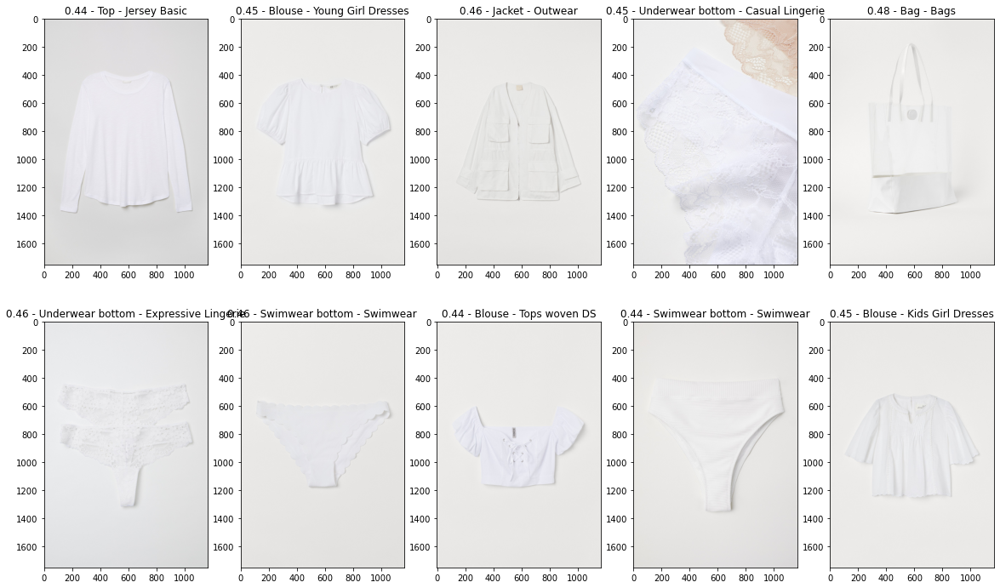

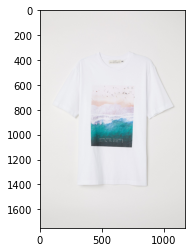

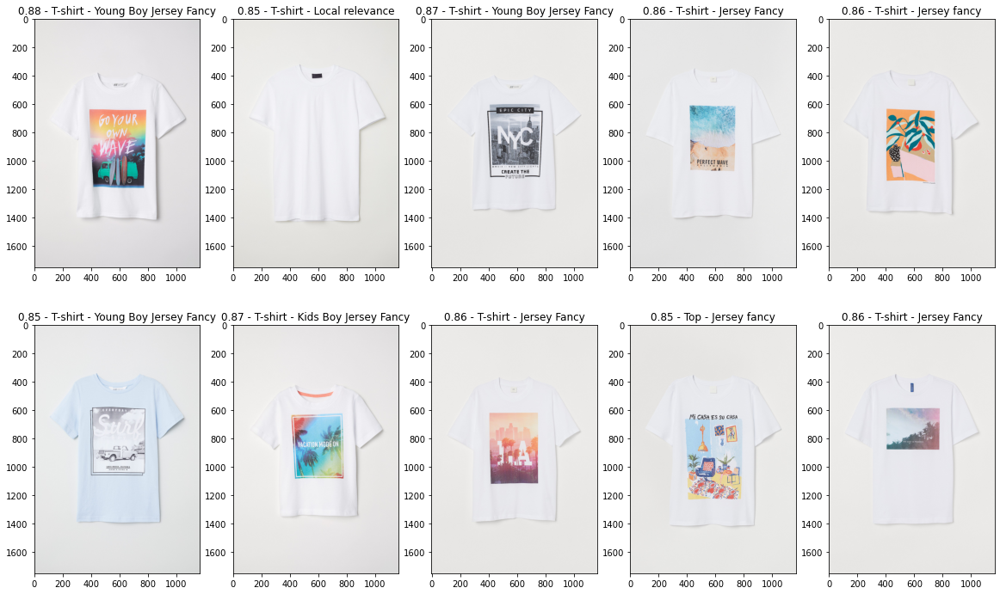

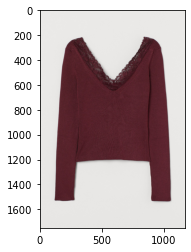

...

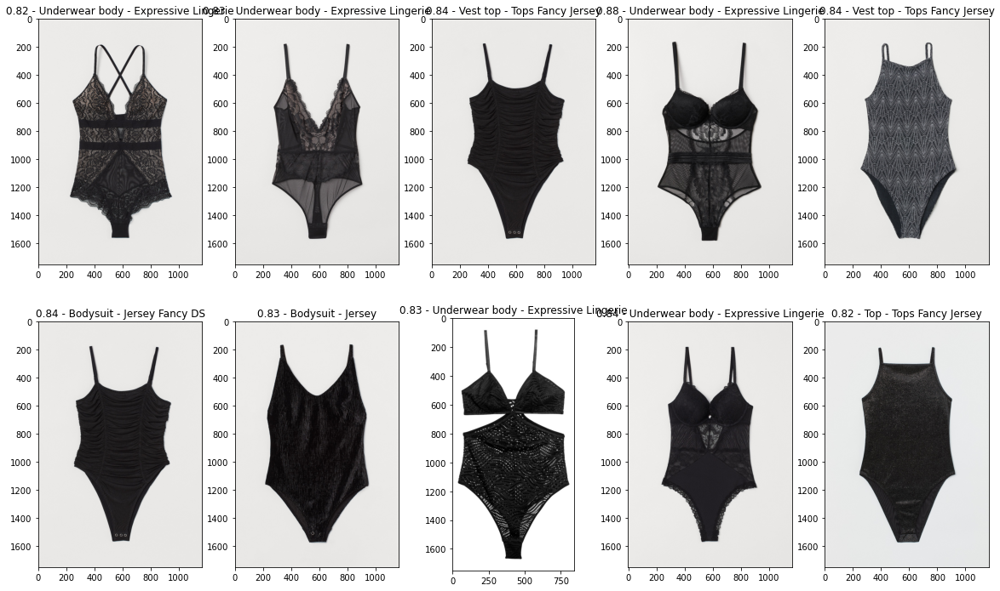

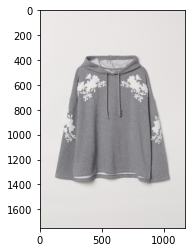

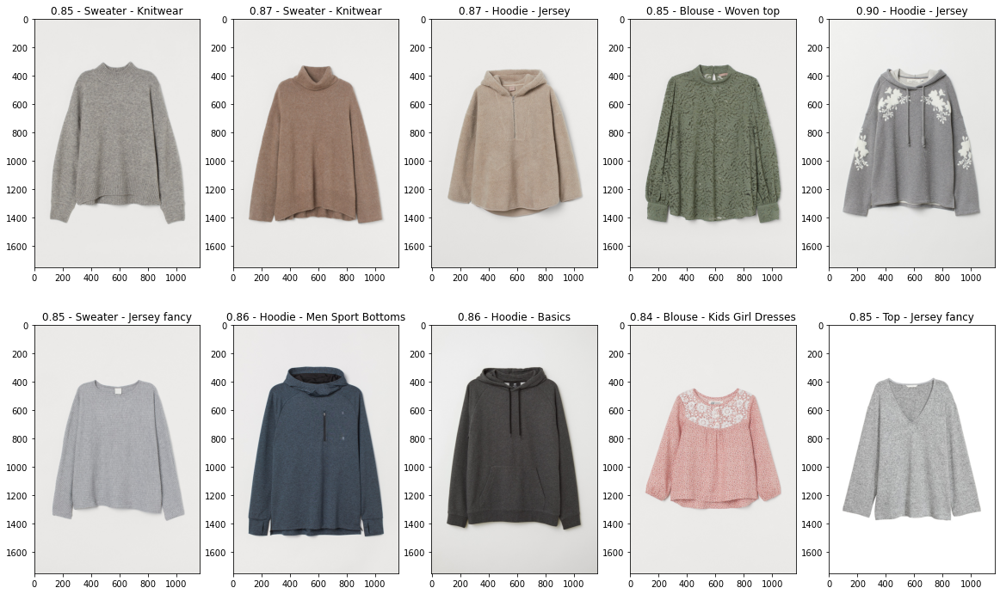

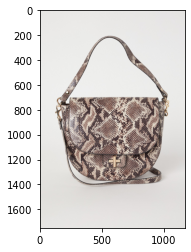

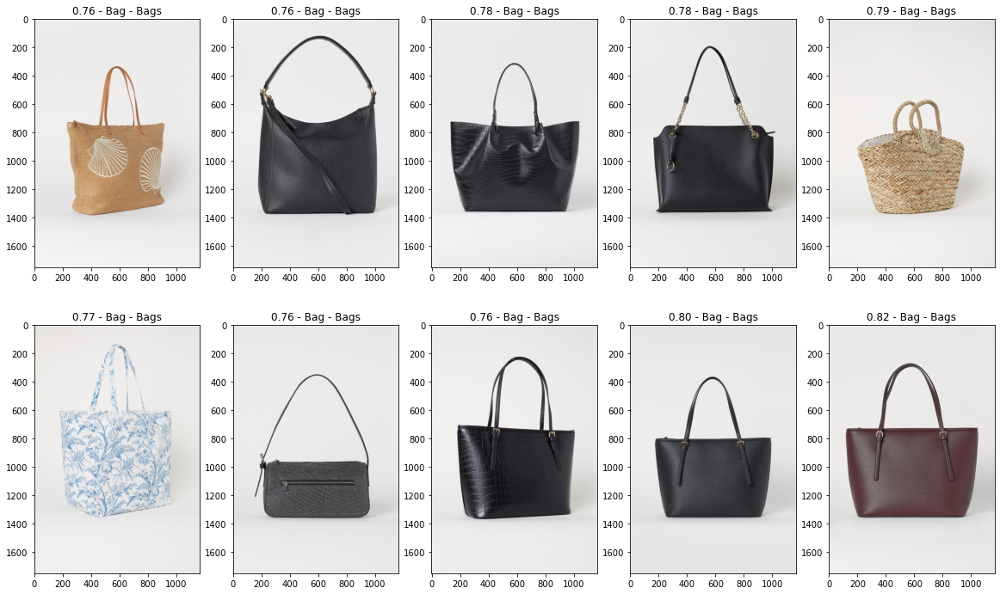

In [42]:
for prod in prod_sample:
    sim_items = return_similar_items_fabric(prod, driver)
    plot_similar_items_fabric(prod, sim_items, all_files)
    plt.pause(2)